In [1]:
import kagglehub
path = kagglehub.dataset_download("python16/summe-videos-and-tvsum-videos")
print("Path to dataset files:", path)

Using Colab cache for faster access to the 'summe-videos-and-tvsum-videos' dataset.
Path to dataset files: /kaggle/input/summe-videos-and-tvsum-videos


In [ ]:
!pip install opencv-python numpy pandas torch torchvision scikit-learn matplotlib tensorflow

Target Video: /kaggle/input/summe-videos-and-tvsum-videos/DataSet/TVSum videos/-esJrBWj2d8.mp4
Using Device: cuda
   -> Reading video file...
   -> Extracted 461 frames for processing.

--- Running Model 1: Bi-LSTM (Supervised) ---
   -> Extracting features using ResNet50 (for Bi-LSTM)...
   -> Saved visualization to ./specific_video_result/-esJrBWj2d8_Model1_BiLSTM.png


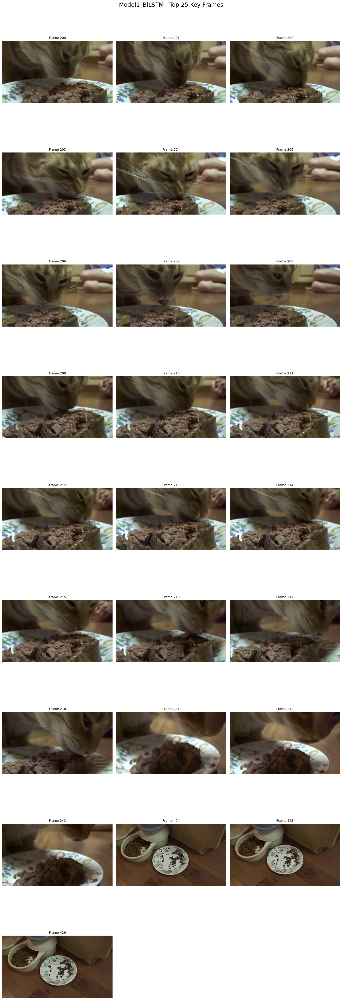


--- Running Model 2: Autoencoder (Unsupervised) ---
   -> Training Autoencoder (Learning video features)...
   -> Clustering to find distinct scenes...
   -> Saved visualization to ./specific_video_result/-esJrBWj2d8_Model2_Autoencoder.png


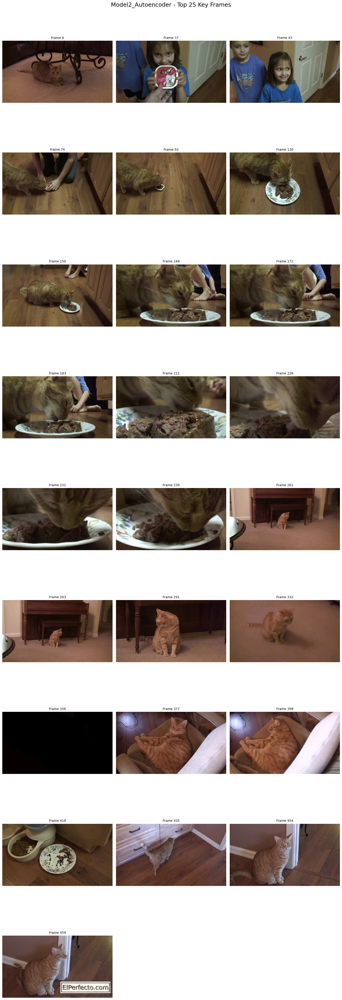


SUCCESS! Check the './specific_video_result' folder for images.


In [12]:
import os
import cv2
import numpy as np
import torch
import torch.nn as nn
import torchvision.models as models
import torchvision.transforms as transforms
from sklearn.cluster import KMeans
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D
from tensorflow.keras.models import Model
from PIL import Image
import matplotlib.pyplot as plt

# ==========================================
# 1. SETUP & CONFIGURATION
# ==========================================
# The exact path you provided
TARGET_VIDEO_PATH = "/kaggle/input/summe-videos-and-tvsum-videos/DataSet/TVSum videos/-esJrBWj2d8.mp4"
OUTPUT_DIR = "./specific_video_result"
SKIP_FRAMES = 15   # Process 1 frame every 15 (approx 2 FPS)
TOP_K_FRAMES = 25   # Number of key frames to find

# Create output folder
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)

print(f"Target Video: {TARGET_VIDEO_PATH}")

# ==========================================
# 2. MODEL DEFINITIONS
# ==========================================

# --- Model 1: Bi-LSTM (Supervised Architecture) ---
class BiLSTMSummarizer(nn.Module):
    def __init__(self, input_dim=2048, hidden_dim=256, num_layers=2):
        super(BiLSTMSummarizer, self).__init__()
        self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers=num_layers, batch_first=True, bidirectional=True)
        self.attention = nn.Sequential(nn.Linear(hidden_dim * 2, 64), nn.Tanh(), nn.Linear(64, 1))
        self.regressor = nn.Linear(hidden_dim * 2, 1)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        att_weights = torch.softmax(self.attention(lstm_out), dim=1)
        frame_scores = torch.sigmoid(self.regressor(lstm_out))
        return frame_scores * att_weights

# --- Model 2: Autoencoder (Unsupervised Architecture) ---
def build_autoencoder():
    input_img = Input(shape=(224, 224, 3))
    # Encoder
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    encoded = Conv2D(8, (3, 3), activation='relu', padding='same')(x) # Latent Space
    # Decoder
    x = Conv2D(8, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(input_img, decoded)
    encoder = Model(input_img, encoded)
    autoencoder.compile(optimizer='adam', loss='binary_crossentropy')
    return autoencoder, encoder

# ==========================================
# 3. HELPER FUNCTIONS
# ==========================================
def extract_resnet_features(frames, device='cpu'):
    print("   -> Extracting features using ResNet50 (for Bi-LSTM)...")
    resnet = models.resnet50(pretrained=True)
    modules = list(resnet.children())[:-1]
    model = nn.Sequential(*modules).to(device)
    model.eval()

    preprocess = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    features = []
    with torch.no_grad():
        for frame in frames:
            img = Image.fromarray(frame)
            input_tensor = preprocess(img).unsqueeze(0).to(device)
            feat = model(input_tensor).flatten().cpu().numpy()
            features.append(feat)
    return np.array(features)

def preprocess_video(video_path):
    print(f"   -> Reading video file...")
    cap = cv2.VideoCapture(video_path)
    frames = []
    original_frames = []
    count = 0
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret: break
        if count % SKIP_FRAMES == 0:
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            original_frames.append(frame_rgb)
            frames.append(cv2.resize(frame_rgb, (224, 224)))
        count += 1
    cap.release()
    return np.array(frames), np.array(original_frames)

def plot_and_save(original_frames, indices, model_name, video_name):
    """
    NEW VERSION: Displays images in a 3-column grid layout
    """
    indices = sorted(indices)
    num_frames = len(indices)
    COLS_PER_ROW = 3
    # Calculate rows needed (3 images per row)
    num_rows = int(np.ceil(num_frames / COLS_PER_ROW))

    # Create figure with appropriate size
    fig = plt.figure(figsize=(15, 5 * num_rows))
    fig.suptitle(f"{model_name} - Top {num_frames} Key Frames", fontsize=18, y=0.995)


    for i, idx in enumerate(indices):
        plt.subplot(num_rows, COLS_PER_ROW, i + 1)
        plt.imshow(original_frames[idx])
        plt.axis('off')
        plt.title(f"Frame {idx}", fontsize=10)


    plt.tight_layout()
    save_path = os.path.join(OUTPUT_DIR, f"{video_name}_{model_name}.png")
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"   -> Saved visualization to {save_path}")
    plt.show()

# ==========================================
# 4. MAIN EXECUTION
# ==========================================
if __name__ == "__main__":

    # Check if file exists
    if not os.path.exists(TARGET_VIDEO_PATH):
        print(f"Error: The file {TARGET_VIDEO_PATH} does not exist.")
        exit()

    video_name = "-esJrBWj2d8"  # Clean name for saving files
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using Device: {device}")

    # A. Preprocessing
    frames, orig_frames = preprocess_video(TARGET_VIDEO_PATH)
    print(f"   -> Extracted {len(frames)} frames for processing.")

    if len(frames) > 0:
        # ----------------------------------------
        # RUN MODEL 1: Bi-LSTM
        # ----------------------------------------
        print("\n--- Running Model 1: Bi-LSTM (Supervised) ---")
        # 1. Get ResNet features (Input for LSTM)
        feats = extract_resnet_features(frames, device)
        input_seq = torch.tensor(feats, dtype=torch.float32).unsqueeze(0).to(device)

        # 2. Run Model (Note: Using random weights as demo)
        model1 = BiLSTMSummarizer().to(device)
        model1.eval()
        with torch.no_grad():
            scores = model1(input_seq).squeeze(0).squeeze(-1).cpu().numpy()

        # 3. Select Top K
        m1_indices = scores.argsort()[-TOP_K_FRAMES:][::-1]
        plot_and_save(orig_frames, m1_indices, "Model1_BiLSTM", video_name)

        # ----------------------------------------
        # RUN MODEL 2: Autoencoder
        # ----------------------------------------
        print("\n--- Running Model 2: Autoencoder (Unsupervised) ---")
        # 1. Normalize frames (0-1)
        X_train = frames.astype('float32') / 255.0

        # 2. Train Autoencoder on THIS video
        print("   -> Training Autoencoder (Learning video features)...")
        ae, encoder = build_autoencoder()
        ae.fit(X_train, X_train, epochs=10, batch_size=8, verbose=0)

        # 3. Cluster the latent space
        print("   -> Clustering to find distinct scenes...")
        latent = encoder.predict(X_train, verbose=0)
        latent_flat = latent.reshape(latent.shape[0], -1)

        kmeans = KMeans(n_clusters=TOP_K_FRAMES, random_state=42)
        kmeans.fit(latent_flat)

        # 4. Find frames closest to cluster centers
        m2_indices = []
        for center in kmeans.cluster_centers_:
            dist = np.linalg.norm(latent_flat - center, axis=1)
            m2_indices.append(np.argmin(dist))

        plot_and_save(orig_frames, m2_indices, "Model2_Autoencoder", video_name)

        print(f"\nSUCCESS! Check the '{OUTPUT_DIR}' folder for images.")
    else:
        print("Error: Video file seems empty or could not be read.")

Visualizing results...


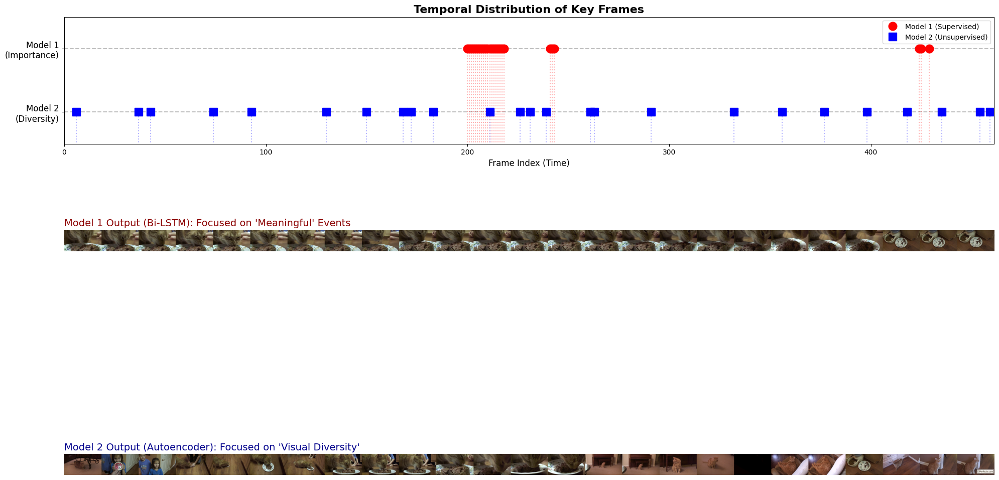

In [13]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

def visualize_comparison(original_frames, m1_indices, m2_indices, video_duration_sec=30):
    total_frames = len(original_frames)
    m1_indices = sorted(m1_indices)
    m2_indices = sorted(m2_indices)


    fig = plt.figure(figsize=(20, 12))
    gs = fig.add_gridspec(3, 1, height_ratios=[1, 2, 2])

    ax_time = fig.add_subplot(gs[0])
    ax_time.set_title("Temporal Distribution of Key Frames", fontsize=16, fontweight='bold')

    ax_time.hlines(1, 0, total_frames, colors='gray', linestyles='dashed', alpha=0.5)
    ax_time.hlines(2, 0, total_frames, colors='gray', linestyles='dashed', alpha=0.5)

    ax_time.plot(m1_indices, [2] * len(m1_indices), 'ro', markersize=12, label='Model 1 (Supervised)')
    for idx in m1_indices:
        ax_time.vlines(idx, 0, 2, colors='red', linestyles='dotted', alpha=0.3)

    ax_time.plot(m2_indices, [1] * len(m2_indices), 'bs', markersize=12, label='Model 2 (Unsupervised)')
    for idx in m2_indices:
        ax_time.vlines(idx, 0, 1, colors='blue', linestyles='dotted', alpha=0.3)

    # Formatting Timeline
    ax_time.set_xlim(0, total_frames)
    ax_time.set_ylim(0.5, 2.5)
    ax_time.set_yticks([1, 2])
    ax_time.set_yticklabels(['Model 2\n(Diversity)', 'Model 1\n(Importance)'], fontsize=12)
    ax_time.set_xlabel("Frame Index (Time)", fontsize=12)
    ax_time.legend(loc='upper right')

    # ===========================
    # 2. MODEL 1 FRAMES (Middle Row)
    # ===========================
    ax_m1 = fig.add_subplot(gs[1])
    ax_m1.axis('off')
    ax_m1.set_title(f"Model 1 Output (Bi-LSTM): Focused on 'Meaningful' Events", fontsize=14, color='darkred', loc='left')

    # Create a horizontal strip of images
    if len(m1_indices) > 0:
        strip_m1 = np.hstack([original_frames[i] for i in m1_indices])
        ax_m1.imshow(strip_m1)

    # ===========================
    # 3. MODEL 2 FRAMES (Bottom Row)
    # ===========================
    ax_m2 = fig.add_subplot(gs[2])
    ax_m2.axis('off')
    ax_m2.set_title(f"Model 2 Output (Autoencoder): Focused on 'Visual Diversity'", fontsize=14, color='darkblue', loc='left')

    if len(m2_indices) > 0:
        strip_m2 = np.hstack([original_frames[i] for i in m2_indices])
        ax_m2.imshow(strip_m2)

    plt.tight_layout()
    plt.show()

# ==========================================
# EXECUTION
# ==========================================
# Run this ONLY if you have variables from the previous step.
# If you restarted the kernel, you will need to re-run the 'single video' script first.

try:
    if 'orig_frames' in globals() and 'm1_indices' in globals() and 'm2_indices' in globals():
        print("Visualizing results...")
        visualize_comparison(orig_frames, m1_indices, m2_indices)
    else:
        print("Variables not found! Please run the 'Single Video' script from the previous step first.")
except Exception as e:
    print(f"Error: {e}")

In [3]:
from IPython.display import Video
video_path = "/kaggle/input/summe-videos-and-tvsum-videos/DataSet/TVSum videos/-esJrBWj2d8.mp4"
Video(video_path, embed=True)